In [1]:
from itertools import product

import numpy as np
import pandas as pd
from scipy import io
import netCDF4 as nc
import h5py
import cv2
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from plotly import graph_objects as go
from tqdm.auto import tqdm
from rich import print as rprint
from rich.traceback import install
install()

<bound method InteractiveShell.excepthook of <ipykernel.zmqshell.ZMQInteractiveShell object at 0x7f2fda9d6640>>

In [2]:
nc_example = './data/nc_of_201904-201906/201904/201904010000ft.nc'

In [ ]:
dataset = nc.Dataset(nc_example)

In [3]:
print(dataset)c

NameError: name 'dataset' is not defined

In [5]:
print(dir(dataset))

[
    '__class__',
    '__delattr__',
    '__dir__',
    '__doc__',
    '__enter__',
    '__eq__',
    '__exit__',
    '__format__',
    '__ge__',
    '__getattr__',
    '__getattribute__',
    '__getitem__',
    '__gt__',
    '__hash__',
    '__init__',
    '__init_subclass__',
    '__le__',
    '__lt__',
    '__ne__',
    '__new__',
    '__orthogonal_indexing__',
    '__reduce__',
    '__reduce_ex__',
    '__repr__',
    '__setattr__',
    '__sizeof__',
    '__str__',
    '__subclasshook__',
    '__unicode__',
    '_close',
    '_close_mem',
    '_enddef',
    '_getname',
    '_grpid',
    '_isopen',
    '_ncstring_attrs__',
    '_redef',
    'close',
    'cmptypes',
    'createCompoundType',
    'createDimension',
    'createEnumType',
    'createGroup',
    'createVLType',
    'createVariable',
    'data_model',
    'delncattr',
    'dimensions',
    'disk_format',
    'enumtypes',
    'file_format',
    'filepath',
    'fromcdl',
    'get_variables_by_attributes',
    'getncattr',
    'groups',
    'isopen',
    'keepweakref',
    'name',
    'ncattrs',
    'parent',
    'path',
    'renameAttribute',
    'renameDimension',
    'renameGroup',
    'renameVariable',
    'set_always_mask',
    'set_auto_chartostring',
    'set_auto_mask',
    'set_auto_maskandscale',
    'set_auto_scale',
    'set_fill_off',
    'set_fill_on',
    'set_ncstring_attrs',
    'setncattr',
    'setncattr_string',
    'setncatts',
    'sync',
    'tocdl',
    'variables',
    'vltypes'
]

In [6]:
for dim in dataset.dimensions.values():
    print(dim)

<class 'netCDF4._netCDF4.Dimension'>: name = 'Time', size = 16

<class 'netCDF4._netCDF4.Dimension'>: name = 'west_east', size = 14

<class 'netCDF4._netCDF4.Dimension'>: name = 'south_north', size = 15

<class 'netCDF4._netCDF4.Dimension'>: name = 'bottom_top', size = 12

In [7]:
for var in dataset.variables.values():
    print(var)
    print(var.name)

<class 'netCDF4._netCDF4.Variable'>
|S1 Times(Time)
unlimited dimensions: 
current shape = (16,)
filling off

Times

<class 'netCDF4._netCDF4.Variable'>
float32 Lat(south_north, west_east)
    description: Latitude
unlimited dimensions: 
current shape = (15, 14)
filling on, default _FillValue of 9.969209968386869e+36 used

Lat

<class 'netCDF4._netCDF4.Variable'>
float32 Lon(south_north, west_east)
    description: Longitude
unlimited dimensions: 
current shape = (15, 14)
filling on, default _FillValue of 9.969209968386869e+36 used

Lon

<class 'netCDF4._netCDF4.Variable'>
float32 height(bottom_top)
    description: Above-Sea level-Height (m)
unlimited dimensions: 
current shape = (12,)
filling off

height

<class 'netCDF4._netCDF4.Variable'>
float32 tsig(bottom_top, south_north, west_east)
    description: Temperature (T)
unlimited dimensions: 
current shape = (12, 15, 14)
filling off

tsig

<class 'netCDF4._netCDF4.Variable'>
float32 rhsig(bottom_top, south_north, west_east)
    description: Humidity (%)
unlimited dimensions: 
current shape = (12, 15, 14)
filling off

rhsig

<class 'netCDF4._netCDF4.Variable'>
float32 usig(bottom_top, south_north, west_east)
    description: Horizontal wind vector (m/s)
unlimited dimensions: 
current shape = (12, 15, 14)
filling off

usig

<class 'netCDF4._netCDF4.Variable'>
float32 vsig(bottom_top, south_north, west_east)
    description: Vertical wind vector (m/s)
unlimited dimensions: 
current shape = (12, 15, 14)
filling off

vsig

<class 'netCDF4._netCDF4.Variable'>
float32 psig(bottom_top, south_north, west_east)
    description: pressure (hPa)
unlimited dimensions: 
current shape = (12, 15, 14)
filling off

psig

In [8]:
''.join(np.array(dataset['Times']).astype(str).tolist())

'2019-04-01_00:00'

In [83]:
print(np.array(dataset['Lon'][:, 0]))
print(np.array(dataset['Lat'][0]))

[113.97053  113.980354 113.99017  114.       114.00982  114.019646
 114.02947  114.03929  114.04912  114.05894  114.06876  114.07858
 114.08841  114.09823  114.108055]

[22.598083 22.589012 22.57994  22.570877 22.561806 22.552727 22.543655
 22.534584 22.525513 22.516441 22.507362 22.498283 22.489212 22.480133]

In [90]:
a = []
for lon, lat in product(np.array(dataset['Lon'][:, 0]), np.array(dataset['Lat'][0])):
    a.append(f'{lon},{lat}')

In [94]:
# '|'.join(a)

In [10]:
np.array(dataset['usig']).shape

(12, 15, 14)

### Collect data

In [11]:
NC_DIR = './data/nc_of_201904-201906'

In [37]:
data_dict = {}
for var in dataset.variables.keys():
    print(var)
    data_dict[var] = []
for month in sorted(os.listdir(NC_DIR)):
    for nc_file in sorted(os.listdir(os.path.join(NC_DIR, month))):
        dataset = nc.Dataset(os.path.join(NC_DIR, month, nc_file))
        assert dataset.variables.keys() == data_dict.keys()
        for key in dataset.variables.keys():
            data_dict[key].append(np.array(dataset[key]))

Times

Lat

Lon

height

tsig

rhsig

usig

vsig

psig

In [38]:
len(data_dict['tsig']) == (30 + 31 + 30) * 24 * 4

True

In [39]:
for k, v in data_dict.items():
    data_dict[k] = np.array(v)

In [43]:
data_dict['Times'] = np.array([''.join(time.astype(str).tolist()) for time in data_dict['Times']])

In [45]:
for k, v in data_dict.items():
    if not k in ('Lat', 'Lon'):
        np.save(f'./data/nc_of_201904-201906/processed/{k.lower()}.npy', v)

### CSV

In [51]:
!cat '/home/tiankang/wusuowei/homework/project/data/trainset/train_station.tsv'

站号	经度	纬度	海拔		
F3	114.0941161	22.54526889	27.755		
F8	114.0836667	22.55606944	41.438		
F10	114.0095556	22.56041667	89.106		
F14	114.052318	22.536497	568.311		
F15	114.0291667	22.572625	64.28		
F17	114.0531111	22.57736944	35.467		
F19	114.09	22.56305556	111.497		
F20	114.0613889	22.52222222	24.318			
F21	114.0141667	22.54888889	37.786		
F22	114.0305556	22.51573611	1.82		
F23	114.0302778	22.51598056	1.82		
F25	114.057124	22.553911	34.093		


In [55]:
!less '/home/tiankang/wusuowei/homework/project/data/trainset/train.tsv'

站号    日期    时间    温度(℃) 湿度(%) 风速(m/s)       风向(°) 气压(hPa)
F3      2019-04-01      00:00   21.2    78      1.2     84      1015.0
F3      2019-04-01      00:15   21.1    77      1.6     71      1015.1
F3      2019-04-01      00:30   21.1    77      1.4     121     1015.1
F3      2019-04-01      00:45   21.0    77      1.3     140     1014.8
F3      2019-04-01      01:00   20.9    77      1.8     150     1014.7
F3      2019-04-01      01:15   20.9    77      1.1     69      1014.8
F3      2019-04-01      01:30   20.9    78      1.2     108     1014.7
F3      2019-04-01      01:45   20.9    77      1.1     137     1014.5
F3      2019-04-01      02:00   20.8    78      1.2     117     1014.6
F3      2019-04-01      02:15   20.8    78      1.1     106     1014.5
F3      2019-04-01      02:30   20.7    78      1.1     131     1014.4
F3      2019-04-01      02:45   20.6    77      1.1     120     1014.4
F3      2019-04-01      03:00   20.6    77      0.9     121     1014.3
F3      2019-04-01 

In [73]:
train_station_df = pd.read_csv('/home/tiankang/wusuowei/homework/project/data/trainset/train_station.tsv', sep='\t', usecols=list(range(0, 4)))
train_station_df.columns = ['station_id', 'longitude', 'latitude', 'altitude']

train_df = pd.read_csv('/home/tiankang/wusuowei/homework/project/data/trainset/train.tsv', sep='\t', usecols=list(range(0, 8)))
train_df.columns = ['station_id', 'date', 'time', 'temperature', 'humidity', 'wind_speed', 'wind_direction', 'air_pressure']

test_station_df = pd.read_csv('/home/tiankang/wusuowei/homework/project/data/testset/test_station.tsv', sep='\t', usecols=list(range(0, 2)))
test_station_df.columns = ['station_id', 'altitude']

In [66]:
train_station_df

,station_id,longitude,latitude,altitude
0,F3,114.094116,22.545269,27.755
1,F8,114.083667,22.556069,41.438
2,F10,114.009556,22.560417,89.106
3,F14,114.052318,22.536497,568.311
4,F15,114.029167,22.572625,64.280
5,F17,114.053111,22.577369,35.467
6,F19,114.090000,22.563056,111.497
7,F20,114.061389,22.522222,24.318
8,F21,114.014167,22.548889,37.786
9,F22,114.030556,22.515736,1.820


In [68]:
test_station_df

,station_id,altitude
0,F1,13.003000
1,F2,86.000000
2,F6,37.456000
3,F7,4.655000
4,F16,5.306000
5,F18,65.261000
6,F4,22.537500
7,F5,22.530278
8,F9,22.544083
9,F11,22.557500


In [75]:
train_df

,station_id,date,time,temperature,humidity,wind_speed,wind_direction,air_pressure
0,F3,2019-04-01,00:00,21.2,78,1.2,84,1015.0
1,F3,2019-04-01,00:15,21.1,77,1.6,71,1015.1
2,F3,2019-04-01,00:30,21.1,77,1.4,121,1015.1
3,F3,2019-04-01,00:45,21.0,77,1.3,140,1014.8
4,F3,2019-04-01,01:00,20.9,77,1.8,150,1014.7
...,...,...,...,...,...,...,...,...
104031,F25,2019-06-30,22:45,29.1,86,0.7,90,999.1
104032,F25,2019-06-30,23:00,29.1,86,0.9,65,999.2
104033,F25,2019-06-30,23:15,29.3,85,1.3,143,999.3
104034,F25,2019-06-30,23:30,29.3,85,1.3,87,999.2


<AxesSubplot:>

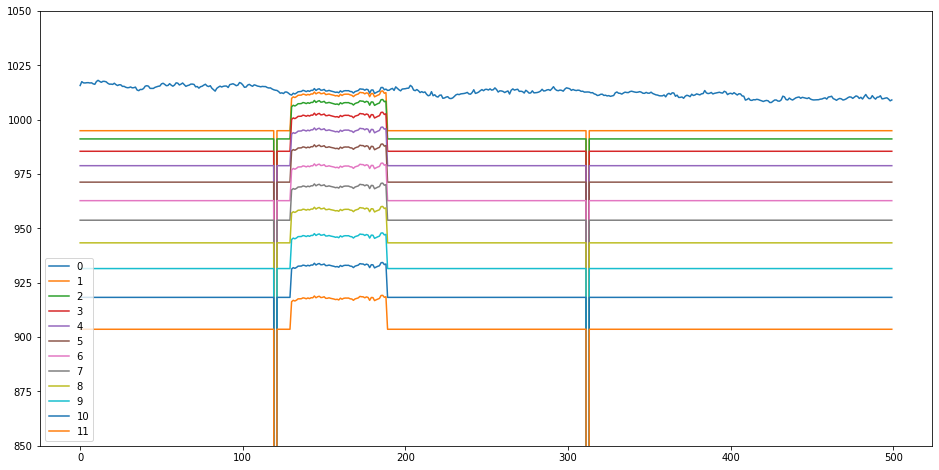

<AxesSubplot:>

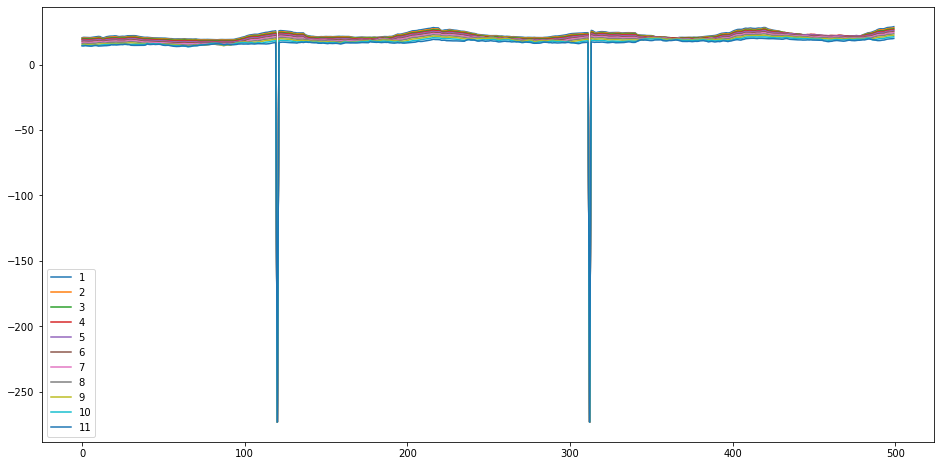

In [203]:
pd.DataFrame(data_dict['tsig'][:500, :, 0, 0]).iloc[:, 1:].plot(kind='line', figsize=(16, 8))

<AxesSubplot:>

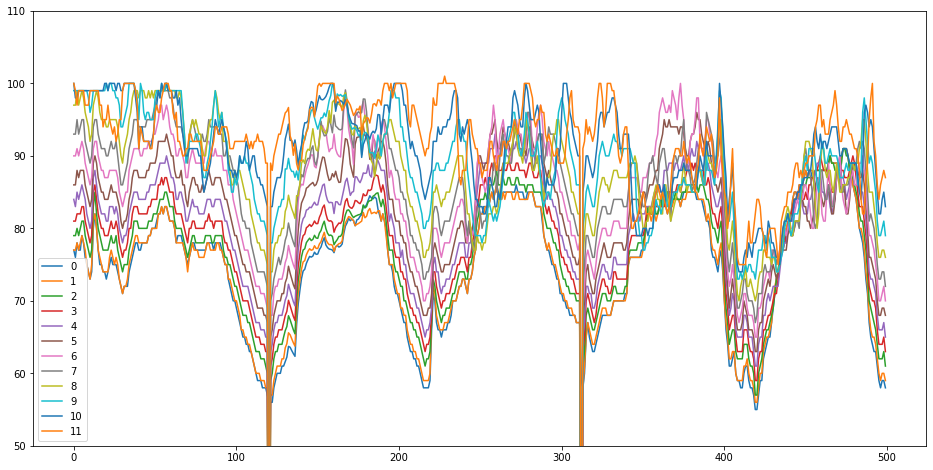

In [231]:
pd.DataFrame(data_dict['rhsig'][:500, :, 0, 0]).iloc[:, :].plot(kind='line', figsize=(16, 8), ylim=[50, 110])

<AxesSubplot:>

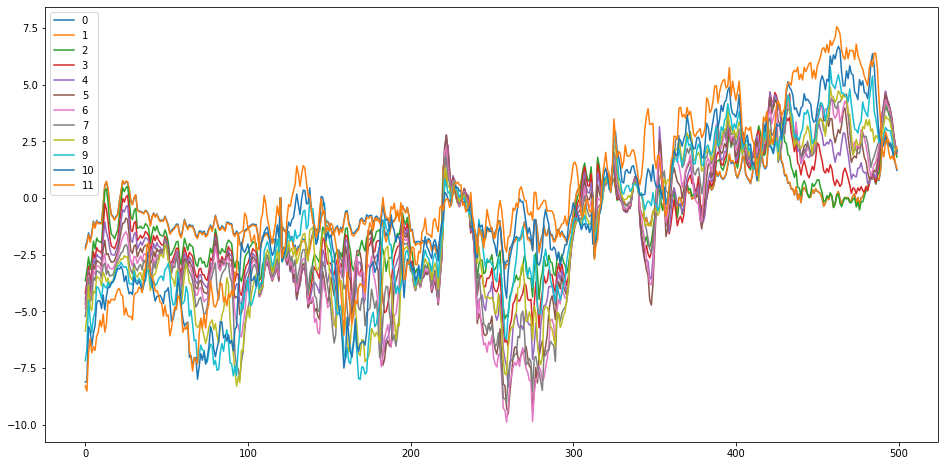

In [238]:
pd.DataFrame(data_dict['usig'][:500, :, 0, 0]).iloc[:, :].plot(kind='line', figsize=(16, 8),)

<AxesSubplot:>

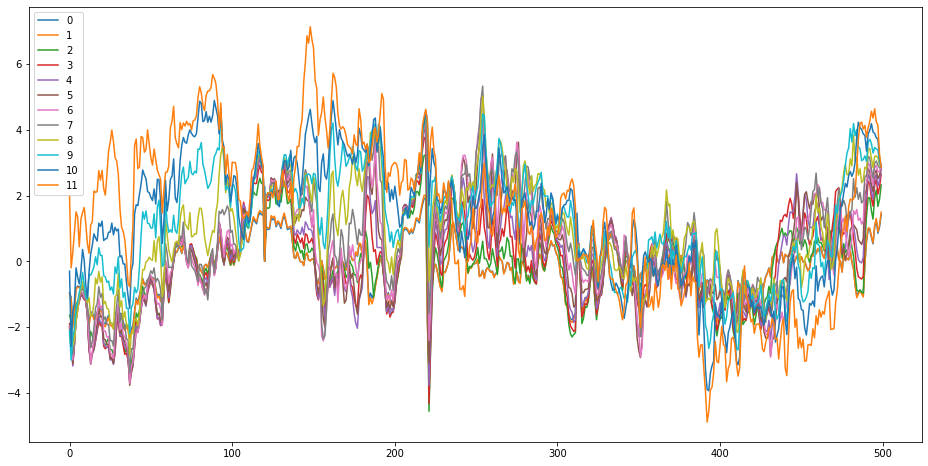

In [242]:
pd.DataFrame(data_dict['vsig'][:500, :, 0, 0]).iloc[:, :].plot(kind='line', figsize=(16, 8),)

In [226]:
print(np.where(data_dict['tsig'][:, 1, 0, 0] < 0))
print(np.where(data_dict['rhsig'][:, 1, 0, 0] < 0))
print(np.where(data_dict['psig'][:, 1, 0, 0] < 500))

(
    array([ 120,  312,  504,  792,  984, 1176, 1224, 1236, 1464, 1536, 1656,
       1848, 2136, 2232, 2328, 2520, 2808, 3000, 3192, 3480, 3672, 3804,
       3864, 4152, 4344, 4536, 4824, 5016, 5208, 5364, 5460, 5496, 5688,
       5880, 6072, 6168, 6360, 6552, 6840, 7032, 7224, 7296, 7416, 7428,
       7440, 7452, 7464, 7476, 7488, 7500, 7512, 7524, 7536, 7548, 7560,
       7572, 7584, 7596, 7608, 7620, 7632, 7644, 7656, 7668, 7680, 7692,
       7704, 7716, 7728, 7740, 7752, 7764, 7776, 7788, 7800, 7812, 7824,
       7836, 7848, 7860, 7872, 7884, 7896, 7908, 7980, 8184, 8232, 8376,
       8400, 8568]),
)

(
    array([ 120,  312,  504,  792,  984, 1176, 1224, 1236, 1464, 1536, 1656,
       1848, 2136, 2232, 2328, 2520, 2808, 3000, 3192, 3480, 3672, 3804,
       3864, 4152, 4344, 4536, 4824, 5016, 5208, 5364, 5460, 5496, 5688,
       5880, 6072, 6168, 6360, 6552, 6840, 7032, 7224, 7296, 7416, 7428,
       7440, 7452, 7464, 7476, 7488, 7500, 7512, 7524, 7536, 7548, 7560,
       7572, 7584, 7596, 7608, 7620, 7632, 7644, 7656, 7668, 7680, 7692,
       7704, 7716, 7728, 7740, 7752, 7764, 7776, 7788, 7800, 7812, 7824,
       7836, 7848, 7860, 7872, 7884, 7896, 7908, 7980, 8184, 8232, 8376,
       8400, 8568]),
)

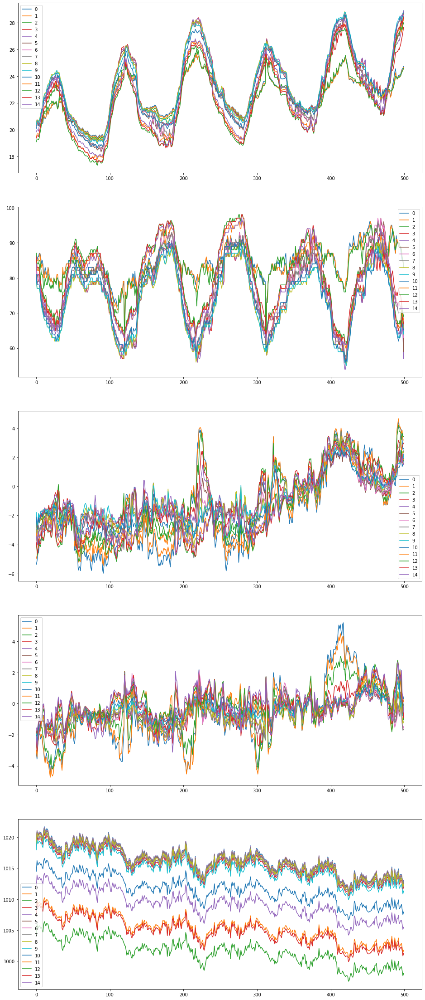

In [250]:
f, axs = plt.subplots(5, 1, figsize=(16, 8 * 5))
for i, name in enumerate(['tsig', 'rhsig', 'usig', 'vsig', 'psig']):
    pd.DataFrame(data_dict[name][:500, 0, :, -1]).iloc[:, :].plot(kind='line', ax=axs[i])

<AxesSubplot:>

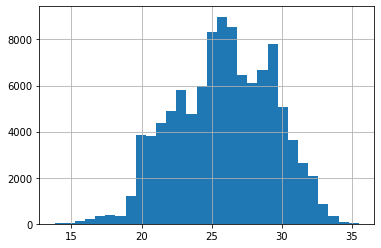

In [79]:
train_df.temperature[train_df.temperature > -999].hist(bins=30)

<AxesSubplot:>

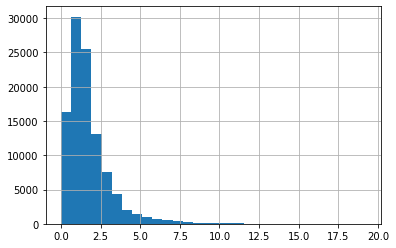

In [80]:
train_df.wind_speed[train_df.wind_speed > -999].hist(bins=30)

<AxesSubplot:>

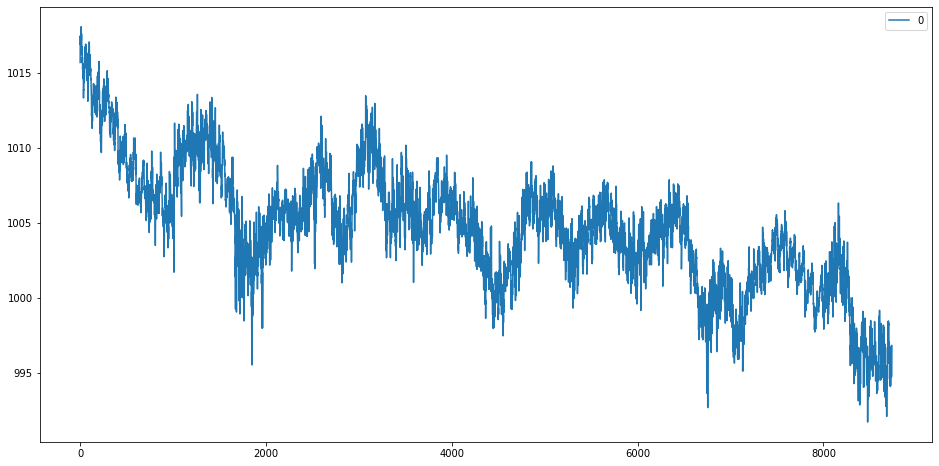

In [200]:
pd.DataFrame(data_dict['psig'][:10000, 0, 0, 0]).plot(kind='line', figsize=(16, 8))

In [153]:
data_df = pd.DataFrame(data_dict['usig'][:1000, :, 0, 0])
f, ax = plt.subplots(figsize=(16, 8))
sns.lineplot(data=data_df, linewidth=1, ax=ax, hue='altitude')
del data_df

╭──────────────────────────── Traceback (most recent call last) ────────────────────────────╮
│ <ipython-input-153-d51dfa38b40c>:2 in <module>                                            │
│                                                                                           │
│ /home/tiankang/software/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:6879   │
│ in pivot                                                                                  │
│                                                                                           │
│   6876 │   def pivot(self, index=None, columns=None, values=None) -> DataFrame:           │
│   6877 │   │   from pandas.core.reshape.pivot import pivot                                │
│   6878 │   │                                                                              │
│ ❱ 6879 │   │   return pivot(self, index=index, columns=columns, values=values)            │
│   6880 │                                                                                  │
│   6881 │   _shared_docs[                                                                  │
│   6882 │   │   "pivot_table"                                                              │
│                                                                                           │
│ /home/tiankang/software/anaconda3/lib/python3.8/site-packages/pandas/core/reshape/pivot.p │
│ y:447 in pivot                                                                            │
│                                                                                           │
│   444 │   │   │   index = [Series(data.index, name=data.index.name)]                      │
│   445 │   │   else:                                                                       │
│   446 │   │   │   index = com.convert_to_list_like(index)                                 │
│ ❱ 447 │   │   │   index = [data[idx] for idx in index]                                    │
│   448 │   │                                                                               │
│   449 │   │   data_columns = [data[col] for col in columns]                               │
│   450 │   │   index.extend(data_columns)                                                  │
│                                                                                           │
│ /home/tiankang/software/anaconda3/lib/python3.8/site-packages/pandas/core/reshape/pivot.p │
│ y:447 in <listcomp>                                                                       │
│                                                                                           │
│   444 │   │   │   index = [Series(data.index, name=data.index.name)]                      │
│   445 │   │   else:                                                                       │
│   446 │   │   │   index = com.convert_to_list_like(index)                                 │
│ ❱ 447 │   │   │   index = [data[idx] for idx in index]                                    │
│   448 │   │                                                                               │
│   449 │   │   data_columns = [data[col] for col in columns]                               │
│   450 │   │   index.extend(data_columns)                                                  │
│                                                                                           │
│ /home/tiankang/software/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:3024   │
│ in __getitem__                                                                            │
│                                                                                           │
│   3021 │   │   if is_single_key:                                                          │
│   3022 │   │   │   if self.columns.nlevels > 1:                                           │
│   3023 │   │   │   │   return self._getitem_multilevel(key)                               │
│ ❱ 3024 │   │   │   indexer = self.columns.get_loc(

<AxesSubplot:>

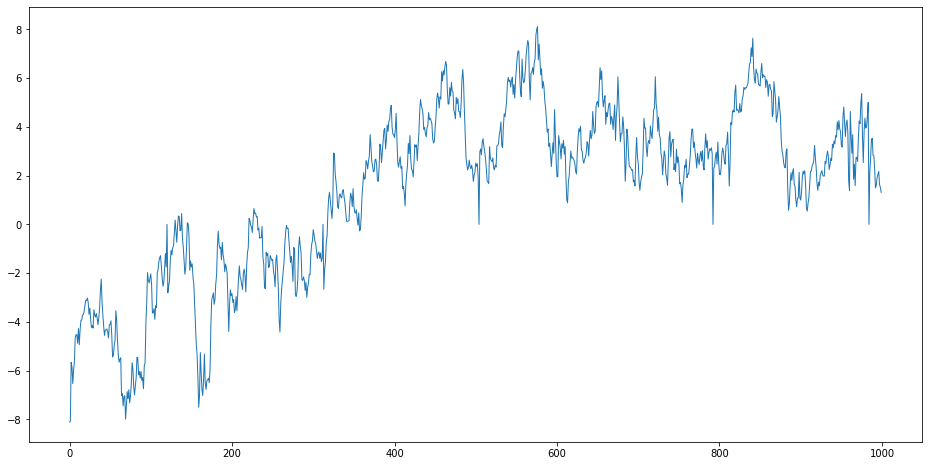

In [146]:
f, ax = plt.subplots(figsize=(16, 8))
sns.lineplot(data=data_dict['usig'][:1000, 12, 0, 0], linewidth=1, ax=ax)

<AxesSubplot:>

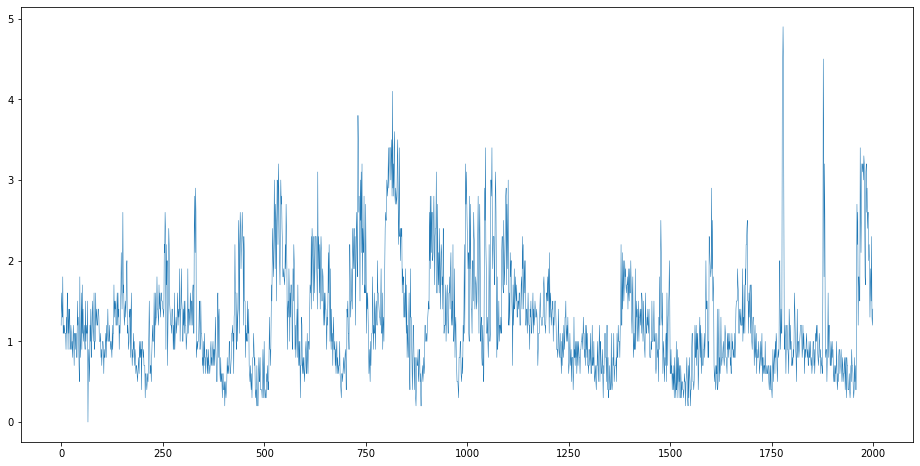

In [127]:
train_df.wind_speed[(train_df.wind_speed > -999) & (train_df.station_id == 'F3')][:2000].plot(kind='line', figsize=(16, 8), linewidth=0.5)

In [110]:
a = []
for _, lon, lat in train_station_df[['longitude', 'latitude']].itertuples():
    a.append(f'{lon},{lat}')

In [111]:
'|'.join(a)

'114.0941161,22.54526889|114.0836667,22.55606944|114.0095556,22.56041667|114.052318,22.536497|114.0291667,22.572625|114.0531111,22.57736944|114.09,22.56305556|114.0613889,22.52222222|114.0141667,22.54888889|114.0305556,22.51573611|114.0302778,22.51598056|114.057124,22.553911'

In [115]:
train_station_df

,station_id,longitude,latitude,altitude
0,F3,114.094116,22.545269,27.755
1,F8,114.083667,22.556069,41.438
2,F10,114.009556,22.560417,89.106
3,F14,114.052318,22.536497,568.311
4,F15,114.029167,22.572625,64.280
5,F17,114.053111,22.577369,35.467
6,F19,114.090000,22.563056,111.497
7,F20,114.061389,22.522222,24.318
8,F21,114.014167,22.548889,37.786
9,F22,114.030556,22.515736,1.820


In [165]:
train_df.to_csv('./data/trainset/train.csv')
train_station_df.to_csv('./data/trainset/train_station.csv')
test_station_df.to_csv('./data/testset/test_station.csv')

In [169]:
np.array(dataset['Lon'])[:, 0]

array([113.97053, 113.97053, 113.97053, 113.97053, 113.97053, 113.97053,
       113.97053, 113.97053, 113.97053, 113.97053, 113.97053, 113.97053,
       113.97053, 113.97053], dtype=float32)

In [173]:
np.save('./data/processed/longitude.npy', np.array(dataset['Lon'])[:, 0])
np.save('./data/processed/latitude.npy', np.array(dataset['Lat'])[0:, ])
np.save('./data/processed/altitude.npy', np.array(dataset['height']))

In [17]:
import os
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

In [8]:
def fillna(path):
    data = np.load(path)
    assert data.shape == (8736, 12, 15, 14)
    data = data.transpose(3, 2, 0, 1).reshape(-1, 12)
    data = np.where(data == data.min(), np.nan, data)
    data = pd.DataFrame(data).fillna(method='ffill').values.reshape(14, 15, -1, 12).transpose(2, 3, 1, 0)
    return data

In [10]:
data = np.empty((8736, 12, 5, 15, 14))
psig = fillna('./data/raw/processed/psig.npy')
rhsig = fillna('./data/raw/processed/rhsig.npy')
tsig = fillna('./data/raw/processed/tsig.npy')
usig = np.load('./data/raw/processed/usig.npy')
vsig = np.load('./data/raw/processed/vsig.npy')
data[:, :, 0, :, :] = psig
data[:, :, 1, :, :] = rhsig
data[:, :, 2, :, :] = tsig
data[:, :, 3, :, :] = usig
data[:, :, 4, :, :] = vsig

In [21]:
with h5py.File('./data/processed/data.h5', 'w') as f:
    f['data'] = data
    f['altitude'] = np.array([  2.,  15.,  60., 120., 180., 250., 330., 420., 520., 630., 750., 900.])
    f['latitude'] = np.array([22.598083, 22.589012, 22.57994 , 22.570877, 22.561806, 22.552727, 22.543655, 22.534584, 22.525513, 22.516441, 22.507362, 22.498283,22.489212, 22.480133])
    f['longitude'] = np.array([113.97053 , 113.980354, 113.99017 , 114.      , 114.00982 , 114.019646, 114.02947 , 114.03929 , 114.04912 , 114.05894 ,114.06876 , 114.07858 , 114.08841 , 114.09823 , 114.108055])
    f['mean'] = data.mean(axis=(0, -2, -1))
    f['std'] = data.std(axis=(0, -2, -1))

In [22]:
means = data.mean(axis=(0, -2, -1))
stds = data.std(axis=(0, -2, -1))

  0%|          | 0/12 [00:00<?, ?it/s]

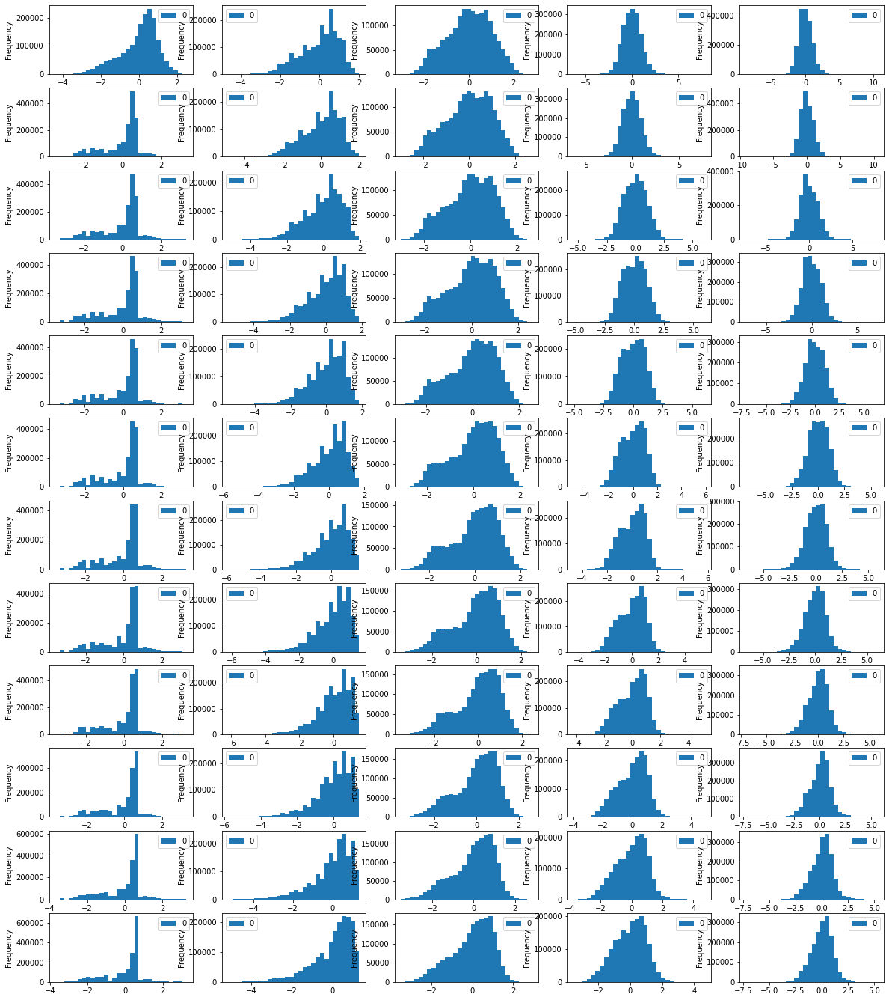

In [23]:
fig, axs = plt.subplots(12, 5, figsize=(20, 24))
for i in tqdm(range(12)):
    for j in range(5):
        pd.DataFrame((data[:, i, j, :, :].flatten() - means[i, j]) / stds[i, j]).plot(kind='hist', bins=30, ax=axs[i, j])
plt.savefig('./imgs/dist.png')

<AxesSubplot:>

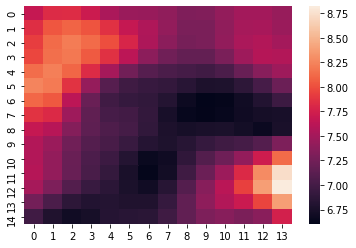

In [110]:
sns.heatmap(data[1234, -1, -1])

<AxesSubplot:>

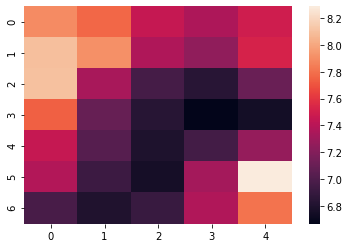

In [112]:
sns.heatmap(cv2.resize(data[1234, -1, -1], (5, 7), interpolation=cv2.INTER_AREA))

<AxesSubplot:>

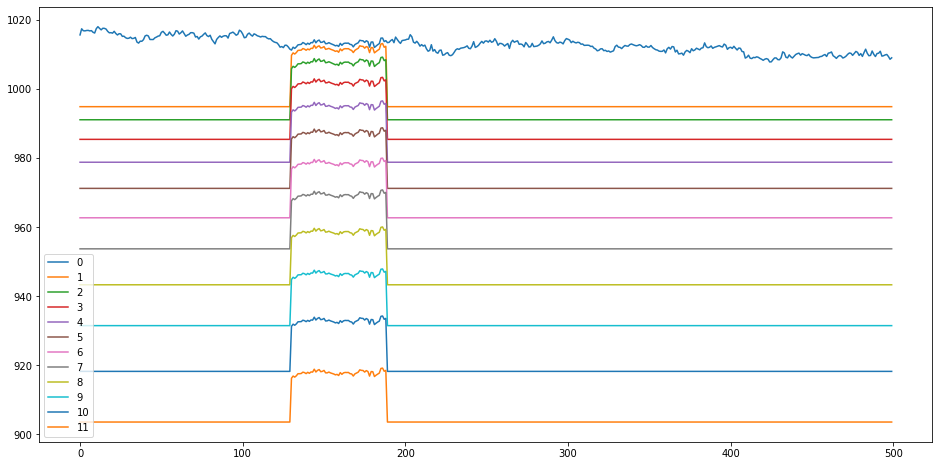

In [85]:
pd.DataFrame(psig[:500, :, 0, 0]).plot(kind='line', figsize=(16, 8))

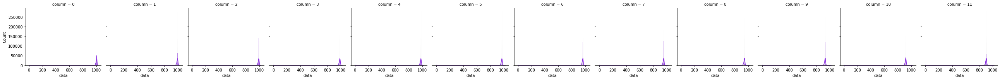

In [13]:
sns.displot(data=pd.DataFrame({"data": psig.ravel(), "column": np.repeat(np.arange(psig.shape[0]), psig.shape[1])}),
            x="data",
            col="column",
            kde=True,
            color='blueviolet',
            height=3
)

In [6]:
data_dir = './data/processed/'

In [8]:
for i in os.listdir(data_dir):
    if i.endswith('npy') and np.load(os.path.join(data_dir, i)).shape == (8736, 12, 15, 14):
        print(i)

psig.npy
rhsig.npy
vsig.npy
tsig.npy
usig.npy


In [9]:
altitude

array([  2.,  15.,  60., 120., 180., 250., 330., 420., 520., 630., 750.,
       900.], dtype=float32)

In [11]:
longitude = np.load('/home/tiankang/wusuowei/homework/project/data/processed/longitude.npy')

In [12]:
longitude[1:] - longitude[:-1]

array([0.00982666, 0.00981903, 0.00982666, 0.00981903, 0.00982666,
       0.00982666, 0.00981903, 0.00982666, 0.00981903, 0.00982666,
       0.00981903, 0.00982666, 0.00981903, 0.00982666], dtype=float32)

In [149]:
def get_last_time(time):
    hour, min_ = time.split(':')
    assert not int(min_) % 15
    if min_ == '00':
        new_min = '45'
        if hour == '00':
            new_hour = '23'
        else:
            new_hour = f'{int(hour) - 1:02d}'
    else:
        new_min = f'{int(min_) - 15:02d}'
        new_hour = hour
    return f'{new_hour}:{new_min}'

In [157]:
get_last_time('00:15'), get_last_time('00:00') , get_last_time('14:15'), get_last_time('10:00'), get_last_time('05:45')

('00:00', '23:45', '14:00', '09:45', '05:30')

In [162]:
def fill(f, new_f):
    f_list = []
    last_station, last_date, last_time = '', '', ''
    for idx, line in enumerate(f):
        if idx == 0:
            # print(f'{line.strip()},mask', file=new_f) if 'mask' not in line else print(line, end='', file=new_f)
            if 'mask' not in line:
                f_list.append(f'{line.strip()},mask')
            else:
                f_list.append(line.strip())
            continue
        station_id, date, time, temperature, humidity, wind_speed, wind_direction, *air_pressure_mask = line.strip().split(',')
        if station_id != last_station:  # a new station. should start from 2019-04-01. last time should be 23:45
            assert date == '2019-04-01'
            if last_time and last_time != '23:45':
                f_list.append(','.join([last_station, last_date, '23:45', '0.0', '0', '0.0', '0', '0.0', '1']))
        elif date != last_date:  # a new day. last time should be 23:45
            if last_time != '23:45':
                f_list.append(','.join([station_id, last_date, '23:45', '0.0', '0', '0.0', '0', '0.0', '1']))
        else:  # next 15min.
            if last_time != get_last_time(time):
                f_list.append(','.join([station_id, date, get_last_time(time), '0.0', '0', '0.0', '0', '0.0', '1']))
        if len(air_pressure_mask) == 1:
            f_list.append(f'{line.strip()},0')
        else:
            f_list.append(line.strip())
        last_station, last_date, last_time = station_id, date, time
    return f_list

In [164]:
with open('./data/raw/processed/train.csv') as f:
    f_list = fill(f, None)
    len_ = len(f_list)
    print(len_)
    i = 0
    while len_ != 12 * 91 * 24 * 4 + 1:
        f_list = fill(f_list, None)
        len_ = len(f_list)
        print(len_)
        i += 1
        if i == 100:
            break

104499
104586
104619
104640
104656
104669
104682
104694
104705
104715
104724
104733
104741
104745
104749
104753
104757
104761
104765
104769
104772
104775
104778
104781
104784
104787
104790
104793
104796
104798
104800
104802
104804
104806
104808
104809
104810
104811
104812
104813
104814
104815
104816
104817
104818
104819
104820
104821
104822
104823
104824
104825
104826
104827
104828
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829
104829


In [166]:
with open('./temp.csv', 'w') as f:
    for i in f_list:
        print(i, file=f)

In [143]:
f_list = fill(f_list, None)
len(f_list)

104825

In [75]:
with open('./data/raw/processed/train.csv') as f, open('./temp0.csv', 'w') as new_f:
    f_list = fill(f, new_f)

In [76]:
with open('./temp0.csv') as f, open('./temp1.csv', 'w') as new_f:
    f_list = fill(f, new_f)

In [77]:
with open('./temp1.csv') as f, open('./temp2.csv', 'w') as new_f:
    f_list = fill(f, new_f)

In [78]:
with open('./temp2.csv') as f, open('./temp3.csv', 'w') as new_f:
    f_list = fill(f, new_f)

In [79]:
with open('./temp3.csv') as f, open('./temp4.csv', 'w') as new_f:
    f_list = fill(f, new_f)

In [187]:
temperatures = np.zeros((12, 91, 24 * 4), dtype=float)
humiditys = np.zeros((12, 91, 24 * 4), dtype=int)
wind_speeds = np.zeros((12, 91, 24 * 4), dtype=float)
wind_directions = np.zeros((12, 91, 24 * 4), dtype=int)
air_pressures = np.zeros((12, 91, 24 * 4), dtype=float)
masks = np.ones((12, 91, 24 * 4), dtype=int)

In [170]:
stations = ["F3", "F8", "F10", "F14", "F15", "F17", "F19", "F20", "F21", "F22", "F23", "F25"]
station_dict = {k: stations.index(k) for k in stations}

In [181]:
def date2idx(date):
    _, month, day = date.split('-')
    if month == '04':
        return int(day) - 1
    elif month == '05':
        return 30 + int(day) - 1
    elif month == '06':
        return 30 + 31 + int(day) - 1
    else:
        raise NotImplementedError

In [177]:
def time2idx(time):
    hour, min_ = time.split(':')
    return int(hour) * 4 + int(min_) // 15

In [190]:
with open('./data/raw/processed/train.csv') as f:
    for idx, line in enumerate(f):
        if idx == 0:
            continue
        station_id, date, time, temperature, humidity, wind_speed, wind_direction, air_pressur = line.strip().split(',')
        idx0, idx1, idx2 = station_dict[station_id], date2idx(date), time2idx(time)
        temperatures[idx0, idx1, idx2] = temperature
        humiditys[idx0, idx1, idx2] = humidity
        wind_speeds[idx0, idx1, idx2] = wind_speed
        wind_directions[idx0, idx1, idx2] = wind_direction
        air_pressures[idx0, idx1, idx2] = air_pressur
        masks[idx0, idx1, idx2] = 0

In [193]:
df = pd.read_csv('./data/raw/processed/train.csv')

In [207]:
np.sort(df.time.unique()).reshape(1, -1).repeat(91, axis=0).flatten()

array(['00:00', '00:15', '00:30', ..., '23:15', '23:30', '23:45'],
      dtype=object)

In [212]:
train_df = pd.DataFrame(
    dict(
        station_id=[stations[i] for i in range(12) for _ in range(91 * 24 * 4)],
        date=df.date.unique().repeat(24 * 4, axis=0).reshape(1, -1).repeat(12, axis=0).flatten(),
        time=np.sort(df.time.unique()).reshape(1, -1).repeat(12 * 91, axis=0).flatten(),
        temperature=temperatures.flatten(),
        humidity=humiditys.flatten(),
        wind_speed=wind_speeds.flatten(),
        wind_direction=wind_directions.flatten(),
        air_pressure=air_pressures.flatten(),
        mask=masks.flatten()
    )
)
train_df.to_csv('./data/processed/train.csv', index=False)

In [229]:
stations = ["F3", "F8", "F10", "F14", "F15", "F17", "F19", "F20", "F21", "F22", "F23", "F25"]

In [279]:
df = pd.read_csv('./data/raw/processed/train_station.csv', index_col=0)
val_df = pd.read_csv('./data/processed/train.csv').query('date == "2019-06-30"')
submit = {}
submit['Lon'] = np.concatenate([np.sort(df.lon.min() - np.random.rand(150 - 12)), df.lon.sort_values().values]).repeat(140).reshape(150, 140)
submit['Lat'] = np.concatenate([np.sort(df.lat.min() - np.random.rand(140 - 12)), df.lat.sort_values().values]).repeat(150).reshape(140, 150).T
lon_idx = df.lon.rank().astype(int) - 1
lat_idx = df.lat.rank().astype(int) - 1
for station in df.index:
    pred = np.random.rand(150, 140, 1, 24)
    pred[lon_idx.loc[station] - 12, lat_idx.loc[station] - 12, 0] = val_df.query(f'station_id == "{station}"').wind_speed[::4]
    submit[station] = pred

In [254]:
from scipy import io

In [280]:
io.savemat('./submit.mat', submit)

In [256]:
io.loadmat('./submit.mat').keys()

dict_keys(['__header__', '__version__', '__globals__', 'Lon', 'Lat', 'station'])

In [ ]:
[114.0095556, 114.0141667, 114.0291667, 114.0302778, 114.0305556,
       114.052318 , 114.0531111, 114.057124 , 114.0613889, 114.0836667,
       114.09     , 114.0941161]

In [173]:
with h5py.File('./data/processed/data.h5') as f:
    data = f['data'][:]
    altitude = f['altitude'][:]

In [12]:
wind_speed = np.sqrt(data[:, :, 3] ** 2 + data[:, :, 4] ** 2)
wind_speed.shape

(8736, 12, 15, 14)

In [53]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

In [174]:
altitude /= 100

In [175]:
altitude = altitude[:10]

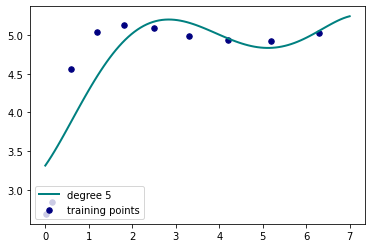

In [176]:
y = wind_speed[np.random.choice(wind_speed.shape[0]), :10, np.random.choice(wind_speed.shape[2]), np.random.choice(wind_speed.shape[3])]
plt.scatter(altitude, y, color='navy', s=30, marker='o', label="training points")
colors = ['teal', 'yellowgreen', 'gold', 'navy']
x_plot = np.linspace(0, 7, 100)
for count, degree in enumerate([5]):
    # model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model = Ridge()
    x_poly = PolynomialFeatures(degree).fit_transform(x_plot[:, None])
    altitude_poly = PolynomialFeatures(degree).fit_transform(altitude[:, None])
    model.fit(np.c_[np.sin(altitude), np.cos(altitude), np.sin(altitude * 2), np.cos(altitude * 2), np.sin(altitude / 2), np.cos(altitude / 2), altitude_poly], y)
    y_plot = model.predict(np.c_[np.sin(x_plot), np.cos(x_plot), np.sin(x_plot * 2), np.cos(x_plot * 2), np.sin(x_plot / 2), np.cos(x_plot / 2), x_poly])
    model.fit(np.c_[altitude_poly], y)
    y_plot = model.predict(np.c_[x_poly])
    plt.plot(x_plot, y_plot, color=colors[count], linewidth=2, label=f"degree {degree}")
plt.legend(loc='lower left')
plt.show()

In [220]:
with h5py.File('./data/processed/data.h5') as f:
    print(f['longitude'][:])
    print(f['latitude'][:])


[113.97053  113.980354 113.99017  114.       114.00982  114.019646
 114.02947  114.03929  114.04912  114.05894  114.06876  114.07858
 114.08841  114.09823  114.108055]
[22.598083 22.589012 22.57994  22.570877 22.561806 22.552727 22.543655
 22.534584 22.525513 22.516441 22.507362 22.498283 22.489212 22.480133]


In [205]:
(lon0 + (lon1 - lon0) / 14 * (- 4 / 9),
lon0 + (lon1 - lon0) / 14 * (130 / 9),
lat0 + (lat1 - lat0) / 13 * (1 / 3),
lat0 + (lat1 - lat0) / 13 * (112 / 9))

(113.96616412698413, 114.11242087301586, 22.483157358974356, 22.5930424017094)

In [43]:
mat = io.loadmat('./data/submit/submit_train.mat')

In [230]:
mat['Lat'] = mat['Lat'][:, ::-1]

In [231]:
io.savemat('./data/submit/submit_test.mat', mat)

<AxesSubplot:>

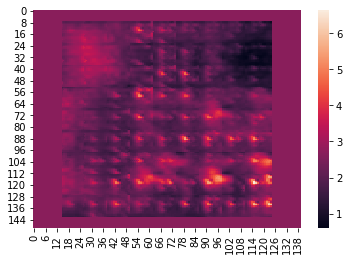

In [45]:
sns.heatmap(mat['F3'][:, :, 0, 0])

In [11]:
df = pd.read_csv('./data/processed/train.csv')

<AxesSubplot:ylabel='Frequency'>

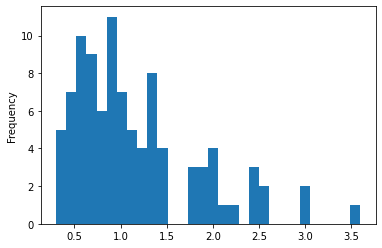

In [30]:
df.query('mask == 0').query('station_id == "F3"').query('date == "2019-06-30"').wind_speed.plot(kind='hist', bins=30)

In [46]:
submit = io.loadmat('./data/submit/submit_train.mat')

<AxesSubplot:ylabel='Frequency'>

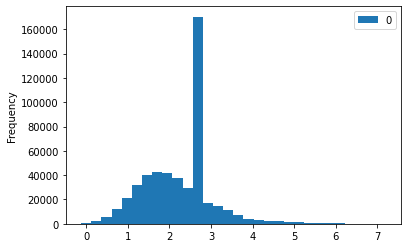

In [47]:
pd.DataFrame(submit['F3'].flatten()).plot(kind='hist', bins=30)

<AxesSubplot:ylabel='Frequency'>

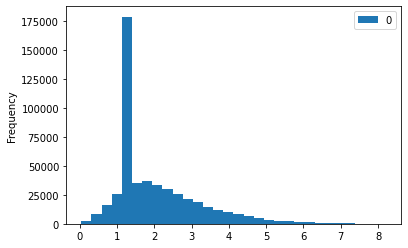

In [27]:
pd.DataFrame(submit['F3'].flatten()).plot(kind='hist', bins=30)


In [23]:
(submit['F8'].flatten() < 0).any()

False

In [48]:
with h5py.File('./data/processed/data_aug.h5') as f:
    data = f['data'][:]

<AxesSubplot:ylabel='Frequency'>

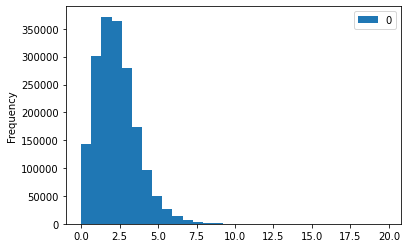

In [49]:
pd.DataFrame(data[:, 1, -1].flatten()).plot(kind='hist', bins=30)

In [ ]:
pd.DataFrame(submit['F3'].flatten()).plot(kind='hist', bins=30)

In [50]:
df = pd.read_csv('./data/processed/train.csv')

In [ ]:
wind = np.power(data[:, :, -3], 2)

<AxesSubplot:ylabel='Frequency'>

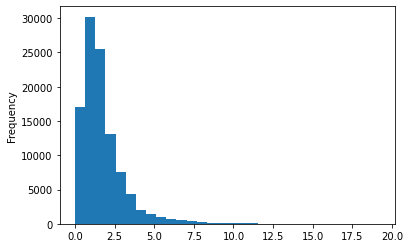

In [205]:
df.query('mask == 0 | wind_speed >= 0').wind_speed.plot(kind='hist', bins=30)

In [63]:
df_temp = df.query('mask == 0 | wind_speed >= 0 | wind_direction > -999')

<AxesSubplot:ylabel='Frequency'>

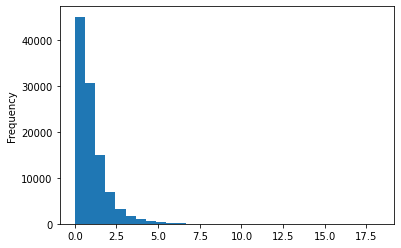

In [77]:
(np.cos(np.deg2rad(df_temp.wind_direction)) * df_temp.wind_speed).abs().plot(kind='hist', bins=30)

<AxesSubplot:ylabel='Frequency'>

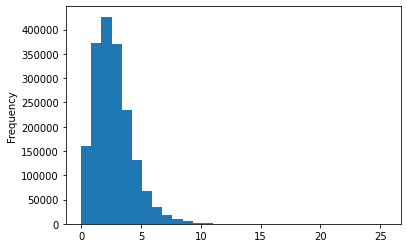

In [204]:
median = np.sqrt(np.power(data[:, 0, -2:], 2).sum(axis=1))
pd.Series(median.flatten()).plot(kind='hist', bins=30)

<AxesSubplot:ylabel='Frequency'>

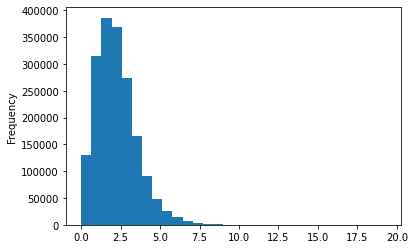

In [206]:
pd.Series(np.abs(data[:, 0, -1].flatten())).plot(kind='hist', bins=30)

In [2]:
with h5py.File('./data/processed/data.h5') as f:
    data = f['data'][:]
    x = f['longitude'][:]
    y = f['latitude'][:]

In [3]:
station_info = pd.read_csv('./data/raw/processed/train_station.csv', index_col='station_id')
train_df = pd.read_csv('./data/processed/train.csv')
train_df.wind_speed.replace(-999, 0, inplace=True)

In [4]:
data.shape

(8736, 12, 5, 15, 14)

In [5]:
wind_speed = np.sqrt(np.power(data[:, 0, -2], 2).sum(axis=1))

In [6]:
# wind_speed = data[:, 0, -1]

In [6]:
time = np.random.choice(8736)
print(time)
z = wind_speed[time]
x1 = station_info.loc[['F22', 'F23']].lon
y1 = station_info.loc[['F22', 'F23']].lat
z1 = train_df.iloc[time::8736].query('station_id == "F22" | station_id == "F23"').wind_speed
fig = go.Figure(data=[
        go.Surface(z=z, x=x, y=y),
        go.Scatter3d(
            x=x1,
            y=y1,
            z=z1,
            mode='markers',
            marker=dict(size=5)
        )
    ]
)
fig.show()

7156


In [8]:
pd.DataFrame(dict(a=data[:6000:4, 0, 5, 6, 9])).plot(kind='line', figsize=(20, 6))

╭──────────────────────────── Traceback (most recent call last) ────────────────────────────╮
│ <ipython-input-8-d93836c1dc80>:1 in <module>                                              │
╰───────────────────────────────────────────────────────────────────────────────────────────╯
IndexError: index 5 is out of bounds for axis 2 with size 5

<AxesSubplot:>

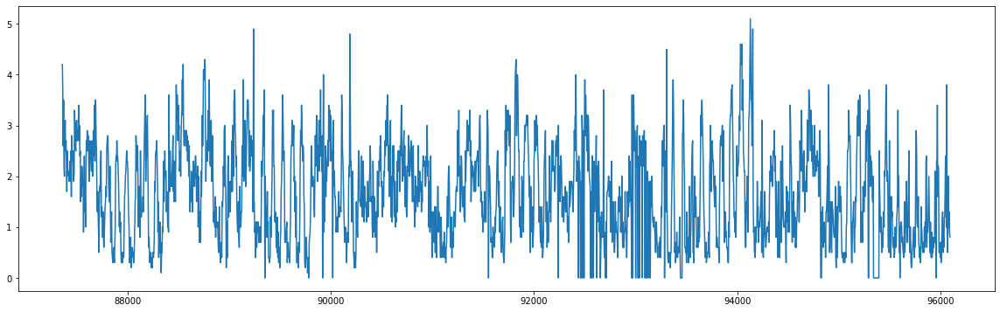

In [283]:
train_df.query('station_id == "F23"').loc[::4].wind_speed.plot(kind='line', figsize=(20, 6))

<AxesSubplot:>

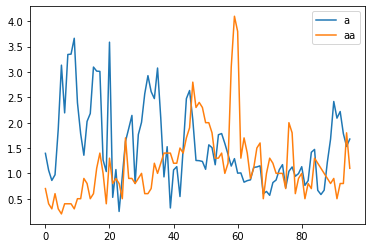

In [273]:
pd.DataFrame(dict(a=wind_speed[-24*4:, 6, 9], aa=train_df.query('station_id == "F23" & date == "2019-06-30"').wind_speed.values)).plot(kind='line')

<AxesSubplot:>

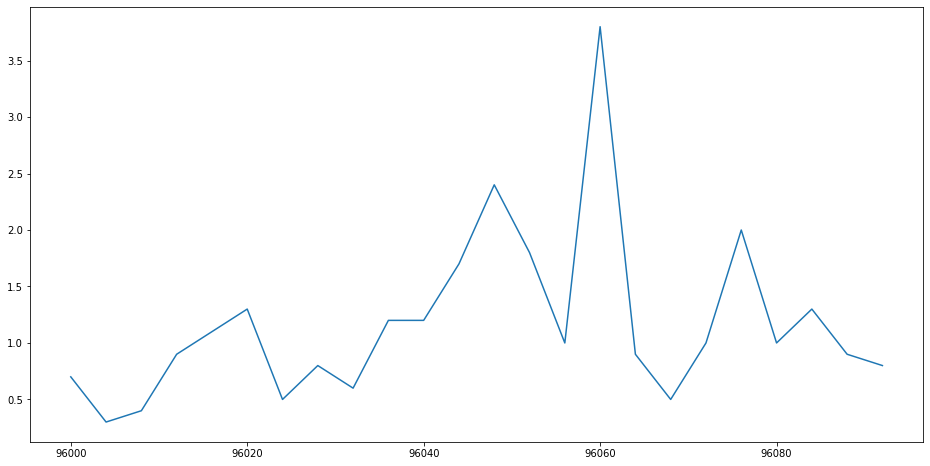

In [282]:
train_df.query('station_id == "F23" & date == "2019-06-30"').loc[::4].wind_speed.plot(kind='line', figsize=(16, 8))

In [242]:
import os

In [239]:
sorted(os.listdir('/home/tiankang/wusuowei/homework/project/data/raw/nc_of_201904-201906/201904'))[:10]

['201904010000ft.nc',
 '201904010015ft.nc',
 '201904010030ft.nc',
 '201904010045ft.nc',
 '201904010100ft.nc',
 '201904010115ft.nc',
 '201904010130ft.nc',
 '201904010145ft.nc',
 '201904010200ft.nc',
 '201904010215ft.nc']